# Item-Based Collaborative Filtering (1st of Memory Based)

In [1]:
# Dataset: https://grouplens.org/datasets/movielens/

# Step 1: Preparing the Data Set
# Step 2: Creating User Movie Df
# Step 3: Making Item-Based Movie Recommendations
# Step 4: Preparing the Working Script

It offers movie recommendations based on the similar liking structure of the movie watched.<br>
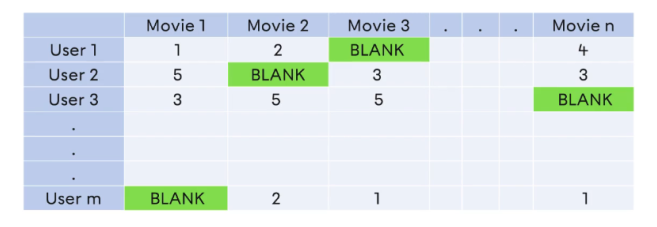 <br>
We focus on the columns and state similar movie that has correlation with our related movie. <br>
We take it out. We can say that society gave similar reactions to these two films.

## Preparing the Data Set

In [26]:
import pandas as pd
pd.set_option('display.max_columns', None)
pd.set_option('display.width', 500)
pd.set_option('display.expand_frame_repr', False)
pd.set_option('display.float_format', lambda x: '%.1f' % x)

In [21]:
movie = pd.read_csv('./datasets/movie.csv')
rating = pd.read_csv('./datasets/rating.csv')    
df = movie.merge(rating, how="left", on="movieId")
df.head(10)

,movieId,title,genres,userId,rating,timestamp
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,7.0,3.0,851866703.0
1,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,9.0,4.0,938629179.0
2,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,13.0,5.0,1331380058.0
3,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,15.0,2.0,997938310.0
4,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,19.0,3.0,855190091.0
5,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,20.0,3.5,1238729767.0
6,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,23.0,3.0,1148729853.0
7,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,26.0,5.0,1360087980.0
8,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,30.0,4.0,944943070.0
9,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,37.0,4.0,981308121.0


In [22]:
df.shape

(117827, 6)

## Creating User Movie Df

In [4]:
# For example, let's say one of the 3 movies has 1000 ratings, the other has 40 ratings, 
# and the other has 3 ratings. If I take these low rating areas into account, the calculation costs would be burdensome. 
#Therefore, I am eliminating such movies here.

In [23]:
df["title"].nunique()

27262

In [24]:
df["title"].value_counts().head()

title
Forrest Gump (1994)                          341
Pulp Fiction (1994)                          324
Shawshank Redemption, The (1994)             311
Silence of the Lambs, The (1991)             304
Star Wars: Episode IV - A New Hope (1977)    291
Name: count, dtype: int64

In [27]:
comment_counts = pd.DataFrame(df["title"].value_counts()); comment_counts

,count
title,
Forrest Gump (1994),341
Pulp Fiction (1994),324
"Shawshank Redemption, The (1994)",311
"Silence of the Lambs, The (1991)",304
Star Wars: Episode IV - A New Hope (1977),291
Jurassic Park (1993),274
"Matrix, The (1999)",259
Toy Story (1995),247
Schindler's List (1993),244


In [30]:
rare_movies = comment_counts[comment_counts["count"] <= 100].index; rare_movies

Index(['Bourne Identity, The (2002)', 'Amadeus (1984)', 'Back to the Future Part II (1989)', 'As Good as It Gets (1997)', 'Catch Me If You Can (2002)', 'Almost Famous (2000)', 'Chicken Run (2000)', 'Life Is Beautiful (La Vita è bella) (1997)', 'Indiana Jones and the Temple of Doom (1984)', 'Hunt for Red October, The (1990)',
       ...
       'Chilly Scenes of Winter (Head Over Heels) (1979)', 'Decoys (2004)', 'Flight of the Living Dead (2007)', 'Martian Child (2007)', 'King of California (2007)', 'Year My Parents Went on Vacation, The (O Ano em Que Meus Pais Saíram de Férias) (2006)', 'Reckless Moment, The (1949)', 'Secret Sunshine (Milyang) (2007)', 'Amanece, que no es poco (1989)', 'Innocence (2014)'],
      dtype='object', name='title', length=27113)

In [31]:
common_movies = df[~df["title"].isin(rare_movies)]
common_movies.shape

(22464, 6)

In [32]:
common_movies["title"].nunique() 

149

In [41]:
# user_movie_df = common_movies.pivot_table(index=["userId"], columns=["title"], values="rating"); user_movie_df
common_movies_cleaned = common_movies.dropna().drop_duplicates(["userId", "title"]); common_movies_cleaned

,movieId,title,genres,userId,rating,timestamp
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,7.0,3.0,851866703.0
1,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,9.0,4.0,938629179.0
2,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,13.0,5.0,1331380058.0
3,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,15.0,2.0,997938310.0
4,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,19.0,3.0,855190091.0
5,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,20.0,3.5,1238729767.0
6,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,23.0,3.0,1148729853.0
7,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,26.0,5.0,1360087980.0
8,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,30.0,4.0,944943070.0
9,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,37.0,4.0,981308121.0


In [42]:
common_movies_cleaned.loc[:, "rating"] = common_movies_cleaned["rating"].astype("float32", copy=False)

In [43]:
common_movies_cleaned.loc[:, "userId"] = common_movies_cleaned["userId"].astype(str,errors='ignore',copy=False); common_movies_cleaned

C:\Users\ASUS\AppData\Local\Temp\ipykernel_4136\2317745305.py:1: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '['7.0' '9.0' '13.0' ... '655.0' '660.0' '664.0']' has dtype incompatible with float64, please explicitly cast to a compatible dtype first.
  common_movies_cleaned.loc[:, "userId"] = common_movies_cleaned["userId"].astype(str,errors='ignore',copy=False); common_movies_cleaned


,movieId,title,genres,userId,rating,timestamp
0,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,7.0,3.0,851866703.0
1,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,9.0,4.0,938629179.0
2,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,13.0,5.0,1331380058.0
3,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,15.0,2.0,997938310.0
4,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,19.0,3.0,855190091.0
5,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,20.0,3.5,1238729767.0
6,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,23.0,3.0,1148729853.0
7,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,26.0,5.0,1360087980.0
8,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,30.0,4.0,944943070.0
9,1,Toy Story (1995),Adventure|Animation|Children|Comedy|Fantasy,37.0,4.0,981308121.0


In [44]:
common_movies_cleaned.loc[:, "userId"] = common_movies_cleaned["userId"].str.split(".", expand=True)[0]

In [45]:
user_movie_df = common_movies_cleaned.pivot_table(index="userId", columns="title", values="rating")

In [46]:
user_movie_df.head()

title,2001: A Space Odyssey (1968),Ace Ventura: Pet Detective (1994),Airplane! (1980),Aladdin (1992),Alien (1979),Aliens (1986),"Amelie (Fabuleux destin d'Amélie Poulain, Le) (2001)",American Beauty (1999),American History X (1998),American Pie (1999),Apocalypse Now (1979),Apollo 13 (1995),Armageddon (1998),Austin Powers: International Man of Mystery (1997),Austin Powers: The Spy Who Shagged Me (1999),Babe (1995),Back to the Future (1985),Batman (1989),Batman Begins (2005),Batman Forever (1995),"Beautiful Mind, A (2001)",Beauty and the Beast (1991),Beetlejuice (1988),Being John Malkovich (1999),Big (1988),"Big Lebowski, The (1998)",Blade Runner (1982),Braveheart (1995),"Breakfast Club, The (1985)","Bug's Life, A (1998)",Casablanca (1942),Clear and Present Danger (1994),Clerks (1994),Cliffhanger (1993),"Clockwork Orange, A (1971)",Clueless (1995),"Crouching Tiger, Hidden Dragon (Wo hu cang long) (2000)",Dances with Wolves (1990),"Dark Knight, The (2008)",Dead Man Walking (1995),Die Hard (1988),Die Hard: With a Vengeance (1995),Dr. Strangelove or: How I Learned to Stop Worrying and Love the Bomb (1964),Dumb & Dumber (Dumb and Dumber) (1994),E.T. the Extra-Terrestrial (1982),Eternal Sunshine of the Spotless Mind (2004),Fargo (1996),Ferris Bueller's Day Off (1986),"Fifth Element, The (1997)",Fight Club (1999),Finding Nemo (2003),"Firm, The (1993)",Forrest Gump (1994),Four Weddings and a Funeral (1994),"Fugitive, The (1993)",Full Metal Jacket (1987),Ghost (1990),Ghostbusters (a.k.a. Ghost Busters) (1984),Gladiator (2000),"Godfather, The (1972)","Godfather: Part II, The (1974)",GoldenEye (1995),Good Will Hunting (1997),Goodfellas (1990),"Green Mile, The (1999)",Groundhog Day (1993),Harry Potter and the Sorcerer's Stone (a.k.a. Harry Potter and the Philosopher's Stone) (2001),Heat (1995),Home Alone (1990),Inception (2010),"Incredibles, The (2004)",Independence Day (a.k.a. ID4) (1996),Indiana Jones and the Last Crusade (1989),Interview with the Vampire: The Vampire Chronicles (1994),Jaws (1975),Jerry Maguire (1996),Jumanji (1995),Jurassic Park (1993),Kill Bill: Vol. 1 (2003),Kill Bill: Vol. 2 (2004),L.A. Confidential (1997),Leaving Las Vegas (1995),"Lion King, The (1994)","Lord of the Rings: The Fellowship of the Ring, The (2001)","Lord of the Rings: The Return of the King, The (2003)","Lord of the Rings: The Two Towers, The (2002)",Léon: The Professional (a.k.a. The Professional) (Léon) (1994),"Mask, The (1994)","Matrix, The (1999)",Memento (2000),Men in Black (a.k.a. MIB) (1997),Minority Report (2002),Mission: Impossible (1996),"Monsters, Inc. (2001)",Monty Python and the Holy Grail (1975),Mrs. Doubtfire (1993),Natural Born Killers (1994),"Net, The (1995)",Ocean's Eleven (2001),Office Space (1999),One Flew Over the Cuckoo's Nest (1975),Outbreak (1995),Pirates of the Caribbean: The Curse of the Black Pearl (2003),Pretty Woman (1990),"Princess Bride, The (1987)",Pulp Fiction (1994),Raiders of the Lost Ark (Indiana Jones and the Raiders of the Lost Ark) (1981),Rain Man (1988),Reservoir Dogs (1992),"Rock, The (1996)",Saving Private Ryan (1998),Schindler's List (1993),Seven (a.k.a. Se7en) (1995),Shakespeare in Love (1998),"Shawshank Redemption, The (1994)","Shining, The (1980)",Shrek (2001),"Silence of the Lambs, The (1991)","Sixth Sense, The (1999)",Sleepless in Seattle (1993),Speed (1994),Spider-Man (2002),Stand by Me (1986),Star Trek: Generations (1994),Star Wars: Episode I - The Phantom Menace (1999),Star Wars: Episode IV - A New Hope (1977),Star Wars: Episode V - The Empire Strikes Back (1980),Star Wars: Episode VI - Return of the Jedi (1983),Stargate (1994),Taxi Driver (1976),Terminator 2: Judgment Day (1991),"Terminator, The (1984)",There's Something About Mary (1998),Titanic (1997),Total Recall (1990),Toy Story (1995),Toy Story 2 (1999),Trainspotting (1996),True Lies (1994),"Truman Show, The (1998)",Twelve Monkeys (a.k.a. 12 Monkeys) (1995),Twister (1996),"Usual Suspects, The (1995)",Waterworld (1995),While You Were Sleeping (199

In [47]:
user_movie_df.shape

(659, 149)

In [36]:
user_movie_df.columns

Index(['2001: A Space Odyssey (1968)', 'Ace Ventura: Pet Detective (1994)', 'Airplane! (1980)', 'Aladdin (1992)', 'Alien (1979)', 'Aliens (1986)', 'Amelie (Fabuleux destin d'Amélie Poulain, Le) (2001)', 'American Beauty (1999)', 'American History X (1998)', 'American Pie (1999)',
       ...
       'Truman Show, The (1998)', 'Twelve Monkeys (a.k.a. 12 Monkeys) (1995)', 'Twister (1996)', 'Usual Suspects, The (1995)', 'Waterworld (1995)', 'While You Were Sleeping (1995)', 'Who Framed Roger Rabbit? (1988)', 'Willy Wonka & the Chocolate Factory (1971)', 'Wizard of Oz, The (1939)', 'X-Men (2000)'],
      dtype='object', name='title', length=149)

## Making Item-Based Movie Suggestions

In [49]:
movie_name = "Matrix, The (1999)"
movie_name = user_movie_df[movie_name]
user_movie_df.corrwith(movie_name).sort_values(ascending=False).head(10)

title
Matrix, The (1999)                                          1.0
Star Trek: Generations (1994)                               0.5
Lord of the Rings: The Two Towers, The (2002)               0.5
Lord of the Rings: The Fellowship of the Ring, The (2001)   0.4
Dark Knight, The (2008)                                     0.4
Fight Club (1999)                                           0.4
Mission: Impossible (1996)                                  0.4
Monsters, Inc. (2001)                                       0.4
Star Wars: Episode VI - Return of the Jedi (1983)           0.4
Inception (2010)                                            0.4
dtype: float64

In [52]:
# PICK A RANDOM MOVIE AND LOOK AT CORRELATION WITH IT
movie_name = pd.Series(user_movie_df.columns).sample(1).values[0]
print(movie_name)
movie_name = user_movie_df[movie_name]
user_movie_df.corrwith(movie_name).sort_values(ascending=False).head(10)

Taxi Driver (1976)


title
Taxi Driver (1976)                       1.0
Full Metal Jacket (1987)                 0.6
Being John Malkovich (1999)              0.5
Apocalypse Now (1979)                    0.5
Fargo (1996)                             0.5
Wizard of Oz, The (1939)                 0.5
Groundhog Day (1993)                     0.5
Kill Bill: Vol. 1 (2003)                 0.4
One Flew Over the Cuckoo's Nest (1975)   0.4
Batman Begins (2005)                     0.4
dtype: float64

In [54]:
def check_film(keyword, user_movie_df):
    return [col for col in user_movie_df.columns if keyword in col]

check_film("Apocalypse Now (1979)", user_movie_df)

['Apocalypse Now (1979)']